In [62]:
!pip install scipy

In [1]:
import pandas as pd
from os import path
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import os
import re
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from scipy.stats import pareto

In [2]:
def truncate(s):
    s_space = s.split(' ')
    s = s_space[0] if len(s_space) == 1 else ' '.join(s_space[:-1])
    s = s.split('(')[0]
    return s

def standardize(s):
    #s = truncate(s)
    s = s.lower()
    s = s[0].upper() + s[1:]
    return s

In [3]:
n_vals = 50000
communes_df = pd.read_csv(os.path.join(os.getcwd(), 'data/communes.csv'), header=None)
communes_df.columns = ['name']
communes_df['name'] = communes_df['name'].apply(standardize)

donations = pareto.rvs(1.5, size=communes_df.shape[0])
donations = (donations*10).astype('int')
donations[donations < 20] = 20

communes_sampled = communes_df.loc[:,'name'].sample(n_vals, replace=True, weights=donations).values  
communes_with_donation = dict(zip(communes_df.loc[:,'name'].tolist(), donations))
communes_with_donation

{'Aclens': 20,
 'Agiez': 47,
 'Aigle': 32,
 'Aire-la-ville': 41,
 'Allaman': 20,
 'Alle': 20,
 'Anieres': 20,
 'Apples': 20,
 'Arbaz': 20,
 'Arconciel': 20,
 'Ardon': 160,
 'Arnex-sur-orbe': 20,
 'Assens': 37,
 'Attalens': 35,
 'Aubonne': 20,
 'Autigny': 35,
 'Avenches': 20,
 'Avry': 20,
 'Avully': 20,
 'Ayent': 20,
 'Ballaigues': 20,
 'Ballens': 20,
 'Bardonnex': 28,
 'Basse-nendaz': 20,
 'Bassecourt': 20,
 'Baulmes': 44,
 'Bavois': 22,
 'Begnins': 28,
 'Belfaux': 24,
 'Bellevue': 20,
 'Belmont-sur-lausanne': 22,
 'Belmont-sur-yverdon': 20,
 'Belprahon': 20,
 'Bercher': 20,
 'Bernex': 20,
 'Berolle': 86,
 'Bettens': 20,
 'Beurnevesin': 20,
 'Bevaix': 20,
 'Bevilard': 20,
 'Bévilard': 27,
 'Bex': 20,
 'Biere': 59,
 'Billen-hennens': 20,
 'Bioley-magnoux': 104,
 'Bioley-orjulaz': 20,
 'Bironico': 20,
 'Blonay': 42,
 'Boecourt': 20,
 'Bofflens': 20,
 'Bole': 20,
 'Boncourt': 20,
 'Bonfol': 20,
 'Bonvillars': 40,
 'Bossonnens': 24,
 'Bottens': 27,
 'Boudry': 21,
 'Bougy-villars': 20,
 'Bo

In [18]:
coloring = np.array(Image.open(path.join(os.getcwd(), 'data/colored_silhouettes.jpg')))

wc = WordCloud(background_color="white", max_words=2000, mask=coloring,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42, relative_scaling=1)
wc.generate_from_frequencies(communes_with_donation)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(200)
fig.set_figwidth(200)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

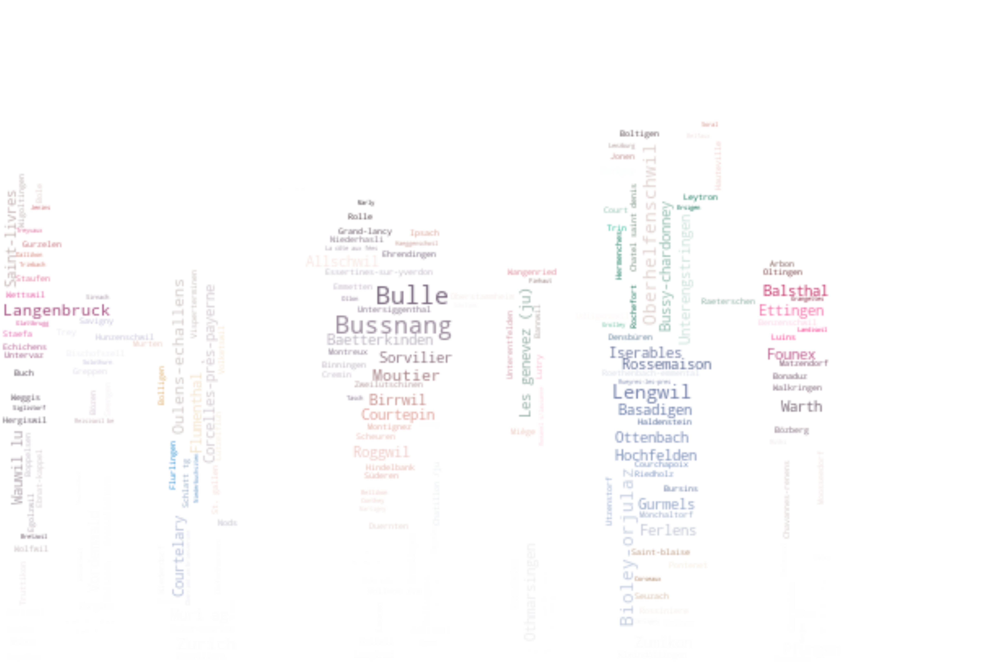

In [11]:
coloring = np.array(Image.open(path.join(os.getcwd(), 'data/children_running.jpg')))

wc = WordCloud(background_color="white", max_words=2000, mask=coloring,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(communes_with_donation)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(100)
fig.set_figwidth(100)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

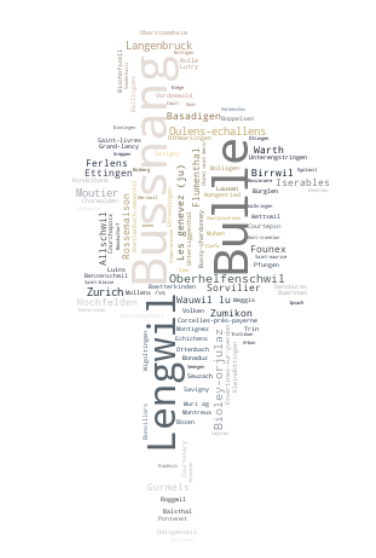

In [15]:
coloring = np.array(Image.open(path.join(os.getcwd(), 'data/child_running.jpg')))

wc = WordCloud(background_color="white", max_words=2000, mask=coloring,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(communes_with_donation)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

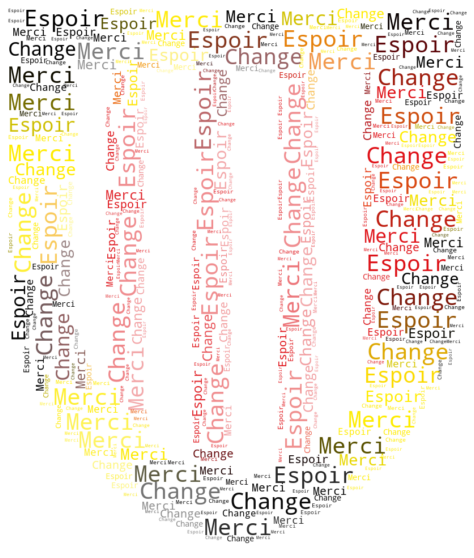

In [70]:
image = Image.open(path.join(os.getcwd(), 'data/ecusson_anieres.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Merci', 'Espoir', 'Change', 'Du fond du cœur', 'De tout cœur']
freqs = [5, 5, 3, 1, 1]
words_and_freqs = dict(zip(words[:3], freqs[:3]))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=2,
               stopwords=None, contour_width=0, max_font_size=20, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

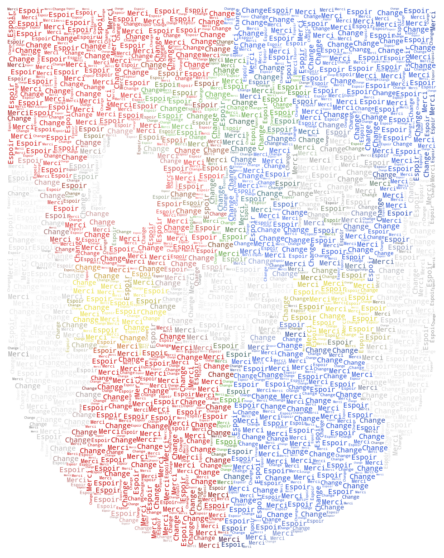

In [50]:
image = Image.open(path.join(os.getcwd(), 'data/ecusson_arzier.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Merci', 'Espoir', 'Change', 'Missing', 'Children', 'Switzerland']
freqs = [5, 5, 3, 1, 1]
words_and_freqs = dict(zip(words[:3], freqs[:3]))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

In [71]:
coloring = np.array(Image.open(path.join(os.getcwd(), 'data/colored_silhouettes.jpg')))

few_communes = communes_df.iloc[:, 0].sample(6).tolist()
words = ['Merci', 'Espoir', 'Change']
freqs = [5]*len(few_communes) + [3]*len(words)
communes_words_and_freq = dict(zip(few_communes + words, freqs))
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=1, max_font_size=40, random_state=42)
wc.generate_from_frequencies(communes_words_and_freq)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(200)
fig.set_figwidth(200)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

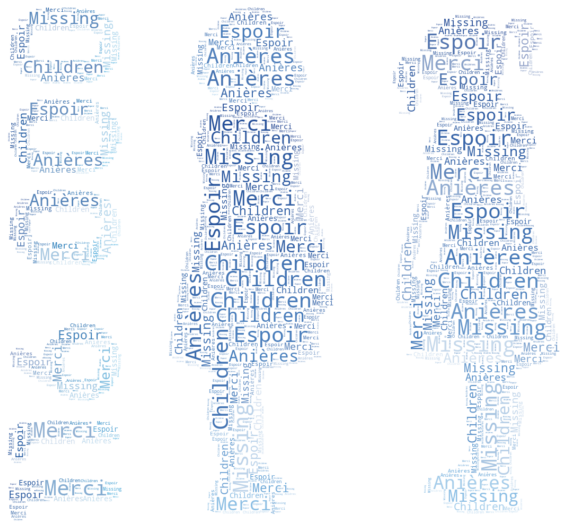

In [6]:
image = Image.open(path.join(os.getcwd(), 'data/#0.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Anières', 'Merci', 'Espoir', 'Missing', 'Children', 'Switzerland']
freqs = [3,3,3,3,3]
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

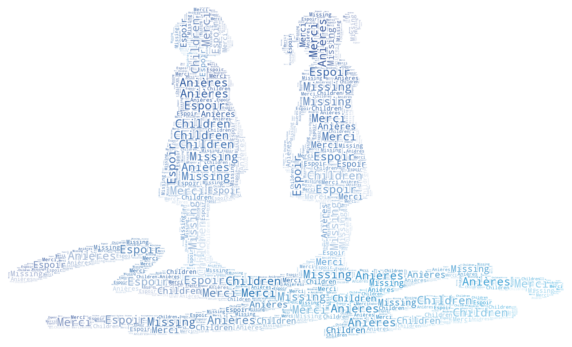

In [8]:
image = Image.open(path.join(os.getcwd(), 'data/#0b.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Anières', 'Merci', 'Espoir', 'Missing', 'Children', 'Switzerland', 'Soutien', 'Famille', 'Papa', 'Maman']
freqs = [3,3,3,3,3]
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

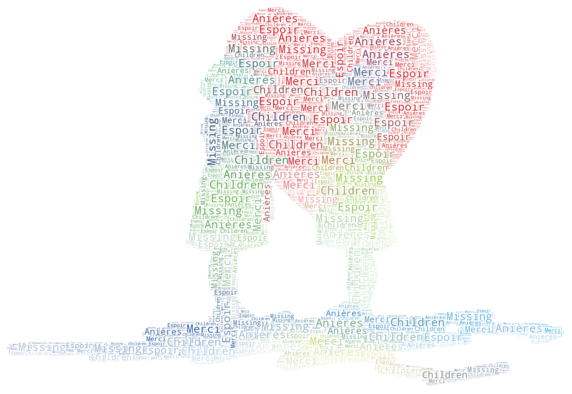

In [9]:
image = Image.open(path.join(os.getcwd(), 'data/#0c.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Anières', 'Merci', 'Espoir', 'Missing', 'Children', 'Switzerland', 'Soutien', 'Famille', 'Papa', 'Maman']
freqs = [3,3,3,3,3]
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

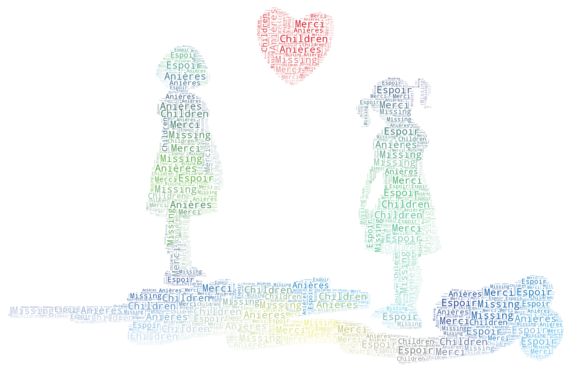

In [10]:
image = Image.open(path.join(os.getcwd(), 'data/#0d.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Anières', 'Merci', 'Espoir', 'Missing', 'Children', 'Switzerland', 'Soutien', 'Famille', 'Papa', 'Maman']
freqs = [3,3,3,3,3]
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

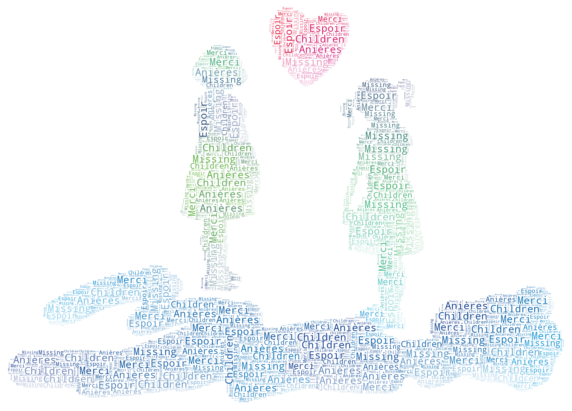

In [11]:
image = Image.open(path.join(os.getcwd(), 'data/#0e.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Anières', 'Merci', 'Espoir', 'Missing', 'Children', 'Switzerland', 'Soutien', 'Famille', 'Papa', 'Maman']
freqs = [3,3,3,3,3]
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.show()

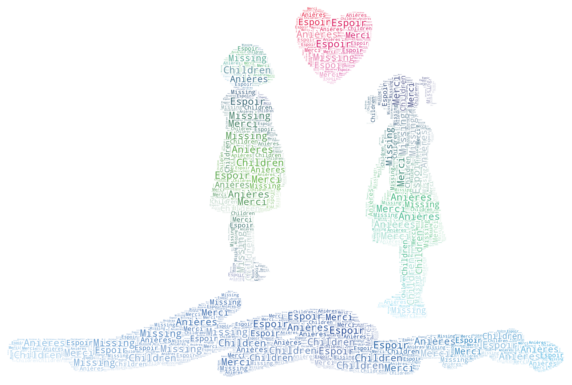

In [15]:
image = Image.open(path.join(os.getcwd(), 'data/#0f.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Anières', 'Merci', 'Espoir', 'Missing', 'Children', 'Switzerland', 'Soutien', 'Famille', 'Papa', 'Maman']
freqs = [3,3,3,3,3]
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(background_color="white", max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=40, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
fig.set_figheight(10)
fig.set_figwidth(10)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.set_axis_off()
plt.savefig('figs/#0f_transformed.png', dpi=800)

/Users/civiliste/opt/anaconda3/lib/python3.8/site-packages/PIL/Image.py:2855: DecompressionBombWarning: Image size (120404840 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


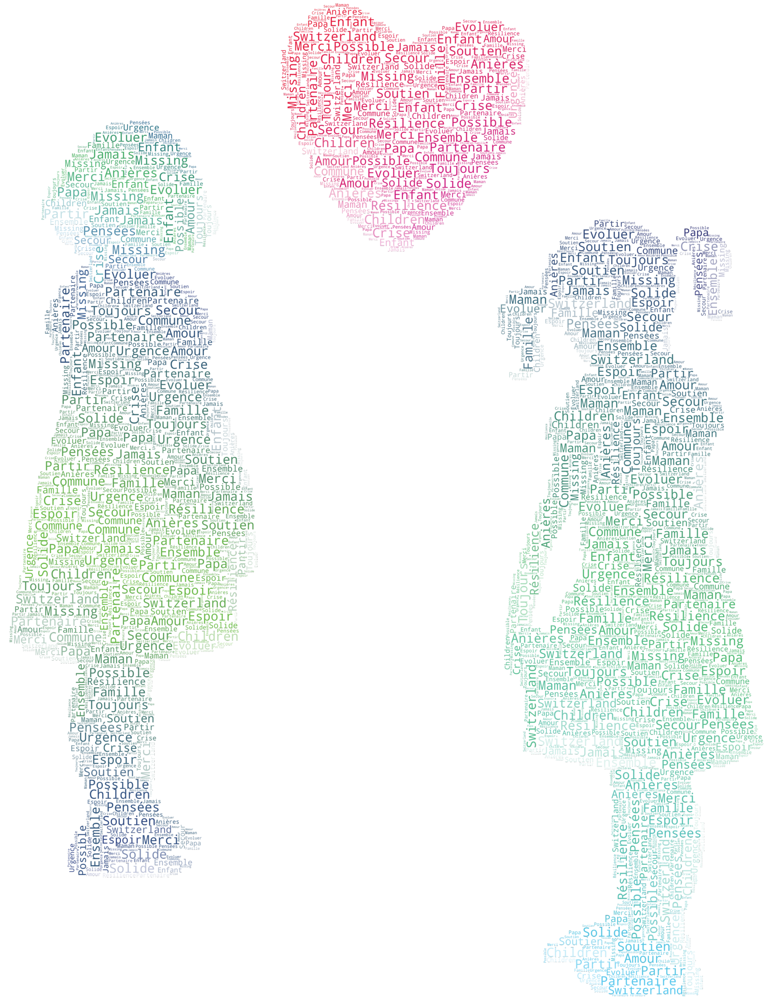

In [10]:
image = Image.open(path.join(os.getcwd(), 'data/#0g_format_reel.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Anières', 'Merci', 'Espoir', 'Missing', 'Children', 'Switzerland', 'Enfant', 'Commune', 'Soutien', 'Famille', 'Résilience', 'Papa', 'Maman', 'Amour', 'Crise', 'Jamais', 'Toujours', 'Partir', 'Solide', 'Pensées', 'Partenaire', 'Ensemble', 'Possible', 'Evoluer', 'Urgence', 'Secour']
freqs = [3]*len(words)
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(mode = "RGBA", width=400, height=300, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=160, random_state=42)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
fig.set_figheight(40)
fig.set_figwidth(40)
ax.set_axis_off()
plt.savefig('figs/#0g_transformed_format_reel.png', dpi=300)

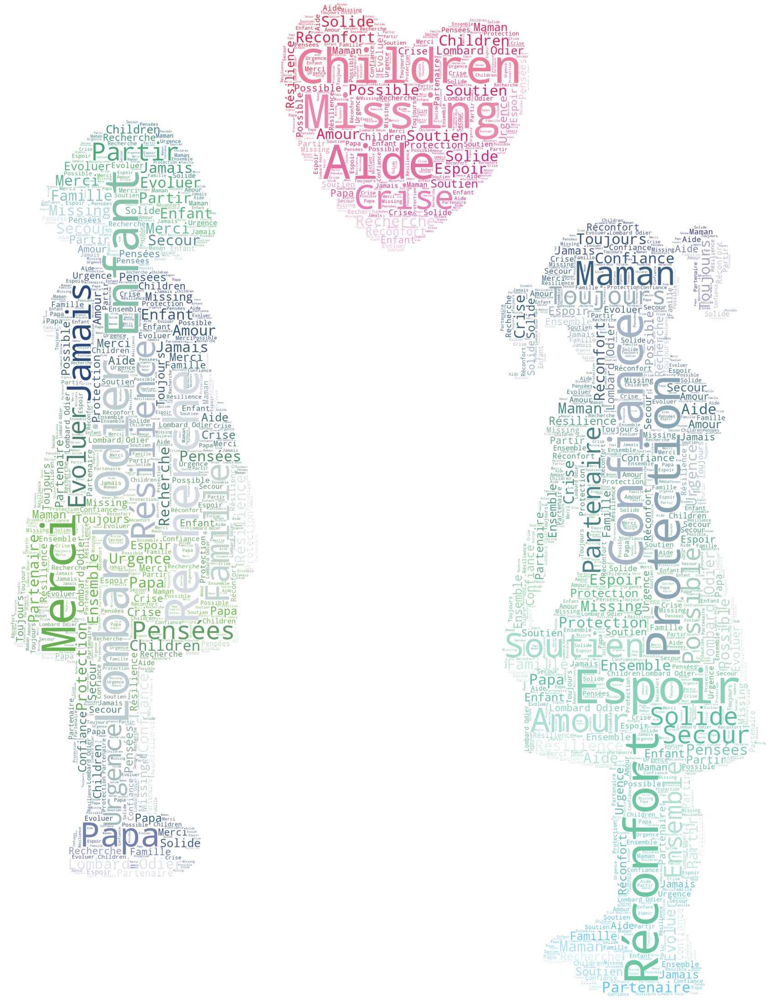

In [5]:
image = Image.open(path.join(os.getcwd(), 'data/#0g_3.png'))
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Lombard Odier', 'Merci', 'Espoir', 'Missing', 'Children', 'Confiance', 'Recherche', 'Aide', 'Réconfort', 'Protection', 'Enfant', 'Soutien', 'Famille', 'Résilience', 'Papa', 'Maman', 'Amour', 'Crise', 'Jamais', 'Toujours', 'Partir', 'Solide', 'Pensées', 'Partenaire', 'Ensemble', 'Possible', 'Evoluer', 'Urgence', 'Secour']
freqs = [3]*len(words)
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
wc = WordCloud(mode = "RGBA", width=400, height=300, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=80, random_state=41)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
fig.set_figheight(40)
fig.set_figwidth(40)
ax.set_axis_off()
plt.savefig('figs/#0g_transformed_format_reel.png', dpi=200)

(2160, 1461, 4)


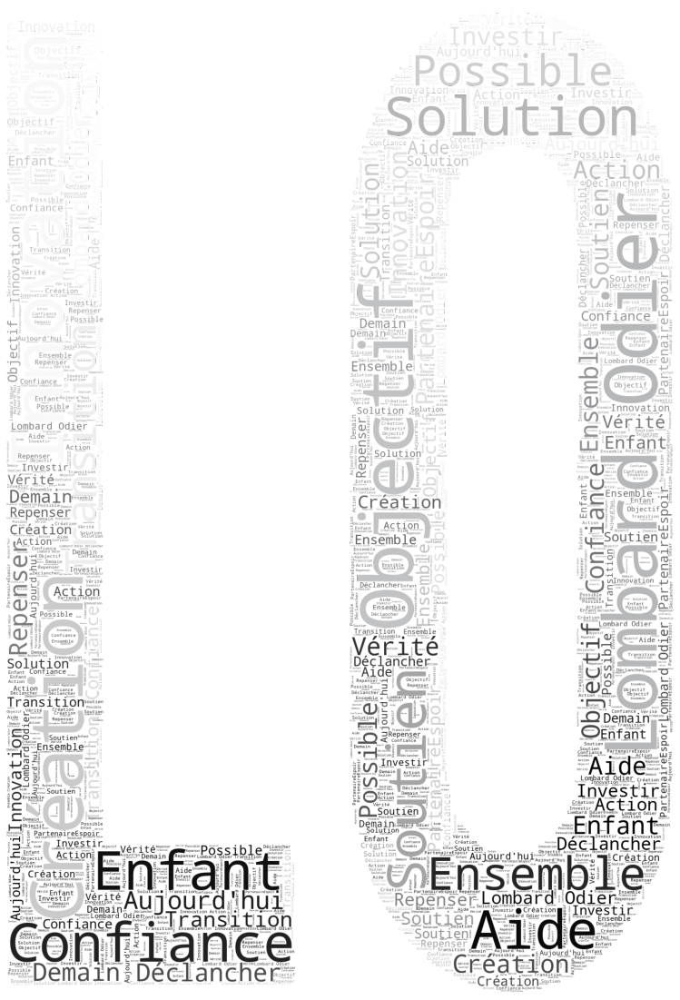

In [33]:
image = Image.open(path.join(os.getcwd(), 'data/OD.png')).convert("RGBA")
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Lombard Odier', 'Création', 'Objectif', 'Innovation', 'Confiance', 'Solution', 'Aide', 'Enfant', 'Soutien', 'Ensemble', 'Possible', 'Transition', "Aujourd'hui", 'Demain', 'Vérité', 'Investir', 'Repenser', 'Action', 'Déclancher', 'Partenaire' 'Espoir']
freqs = [3]*len(words) 
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(image)
print(coloring.shape)
wc = WordCloud(mode = "RGBA", width=1600, height=800, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=160, random_state=50)
wc.generate_from_frequencies(words_and_freqs)
image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
ax.imshow(wc.recolor(color_func=image_colors))
fig.set_figheight(20)
fig.set_figwidth(20)
ax.set_axis_off()
plt.savefig('figs/OD_transformed_6.png', dpi=200)

(855, 1800, 4)


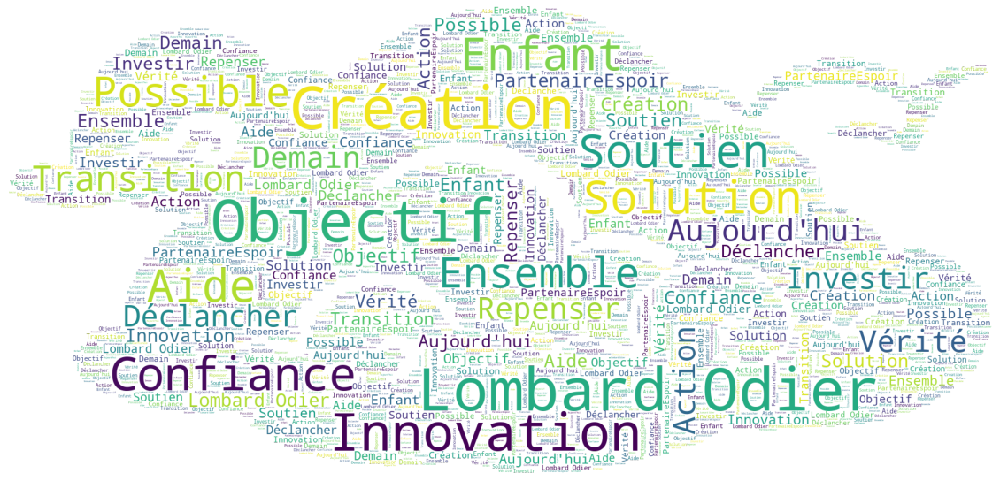

In [41]:
image = Image.open(path.join(os.getcwd(), 'data/clouds.png')).convert("RGBA")
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

words = ['Lombard Odier', 'Création', 'Objectif', 'Innovation', 'Confiance', 'Solution', 'Aide', 'Enfant', 'Soutien', 'Ensemble', 'Possible', 'Transition', "Aujourd'hui", 'Demain', 'Vérité', 'Investir', 'Repenser', 'Action', 'Déclancher', 'Partenaire' 'Espoir']
freqs = [3]*len(words) 
words_and_freqs = dict(zip(words, freqs))
coloring = np.array(new_image)
print(coloring.shape)
wc = WordCloud(mode = "RGBA", width=1600, height=800, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=160, random_state=30)
wc.generate_from_frequencies(words_and_freqs)
#image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
ax.imshow(wc)
fig.set_figheight(20)
fig.set_figwidth(20)
ax.set_axis_off()
plt.savefig('figs/clouds_transformed.png', dpi=200)

In [67]:
import random
random.sample(communes_with_donation.keys(), 50)

['Renens',
 'Kallern ag',
 'La neuveville',
 'Disentis/muster',
 'Bottighofen',
 'Saint-oyens',
 'Lupsingen',
 'Nuvilly',
 'Andermatt',
 'Röschenz',
 'Rodersdorf',
 'Schinznach-bad',
 'Diemerswil',
 'Murten',
 'S-chanf',
 'Kirchleerau',
 'Forel (lavaux)',
 'Nods',
 'Avully',
 'St. moritz',
 'Zwingen',
 'Corbeyrier',
 'Boncourt',
 'Rolle',
 'Balgach',
 'Brétigny-sur-morrens',
 'Zetzwil',
 'Agiez',
 'Cortaillod',
 'Rovray',
 'Tolochenaz',
 'Wolfhalden',
 'Homburg',
 'Subingen',
 'Frutigen',
 'Uster',
 'Mitlödi',
 'Gontenschwil',
 'Knonau',
 'Oberneunforn',
 'Bürchen',
 'Ennetmoos',
 'Schupfart',
 'Bonstetten',
 'Guettingen',
 'Massonnens',
 'Holziken',
 'Seengen',
 'Yens',
 'Villarsiviriaux']

In [8]:
selected_communes = ['Renens',
 'Kallern',
 'La neuveville',
 'Bottighofen',
 'Saint-oyens',
 'Lupsingen',
 'Nuvilly',
 'Andermatt',
 'Röschenz',
 'Rodersdorf',
 'Schinznach-bad',
 'Diemerswil',
 'Murten',
 'S-chanf',
 'Kirchleerau',
 'Forel',
 'Nods',
 'Avully',
'Lausanne',
 'Zwingen',
 'Corbeyrier',
 'Boncourt',
 'Rolle',
 'Balgach',
 'Brétigny-sur-morrens',
 'Zetzwil',
 'Agiez',
 'Cortaillod',
 'Rovray',
 'Tolochenaz',
 'Wolfhalden',
 'Homburg',
 'Subingen',
 'Frutigen',
 'Uster',
 'Mitlödi',
 'Gontenschwil',
 'Knonau',
 'Oberneunforn',
 'Bürchen',
 'Ennetmoos',
 'Schupfart',
 'Bonstetten',
 'Guettingen',
 'Massonnens',
 'Holziken',
 'Seengen',
 'Yens',
 'Villarsiviriaux']

background_words = ['Merci', 'Espoir', 'Missing', 'Children', 'Confiance', 'Recherche', 'Aide', 'Réconfort', 'Protection', 'Enfant', 'Soutien', 'Famille', 'Résilience', 'Papa', 'Maman', 'Amour', 'Crise', 'Jamais', 'Toujours', 'Partir', 'Solide', 'Pensées', 'Partenaire', 'Ensemble', 'Possible', 'Evoluer', 'Urgence', 'Secour']
words_and_freqs = dict(zip(selected_communes + background_words, [6]*len(selected_communes) + [2]*len(selected_communes)))

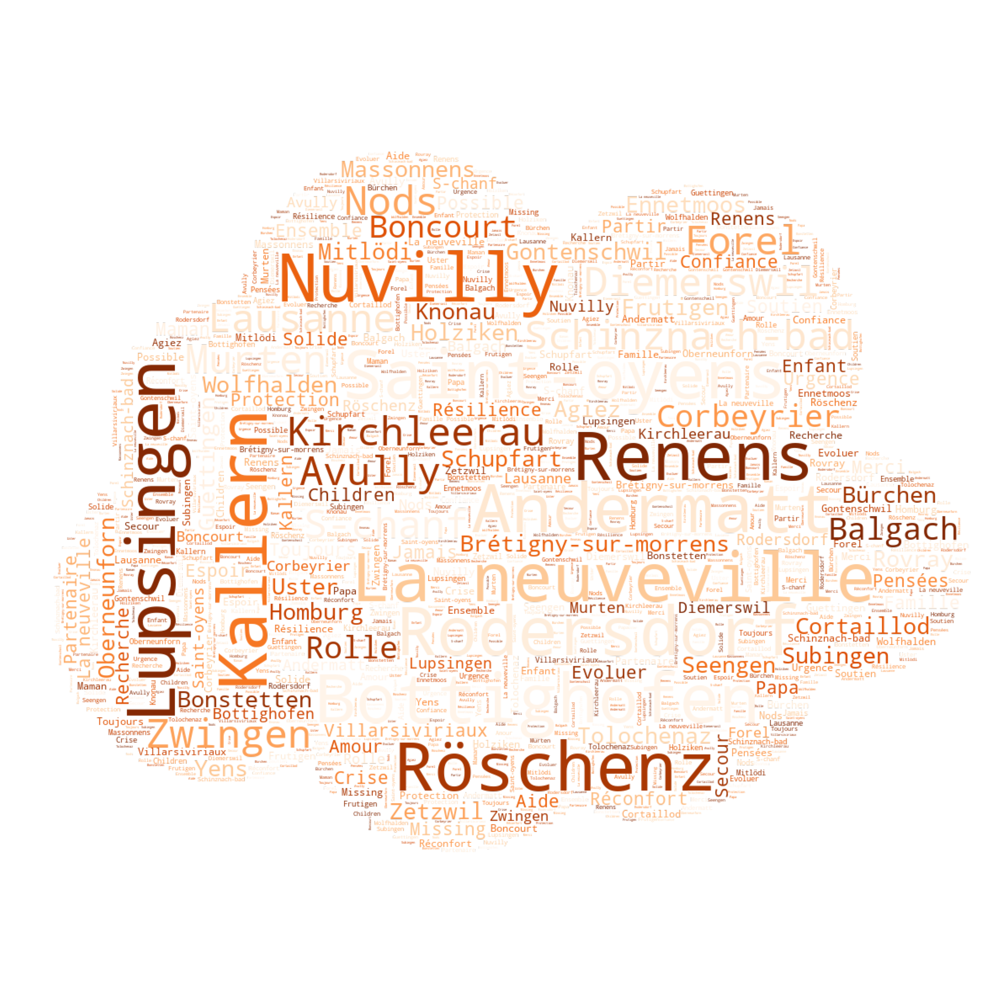

In [10]:


image = Image.open(path.join(os.getcwd(), 'data/cloud.png')).convert('RGBA')
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

coloring = np.array(new_image)
wc = WordCloud(mode = "RGBA", width=400, height=300, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=80, random_state=41, colormap='Oranges')
wc.generate_from_frequencies(words_and_freqs)
#image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
#ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.imshow(wc)

fig.set_figheight(40)
fig.set_figwidth(40)
ax.set_axis_off()
plt.savefig('figs/#0g_transformed_format_reel.png', dpi=200)

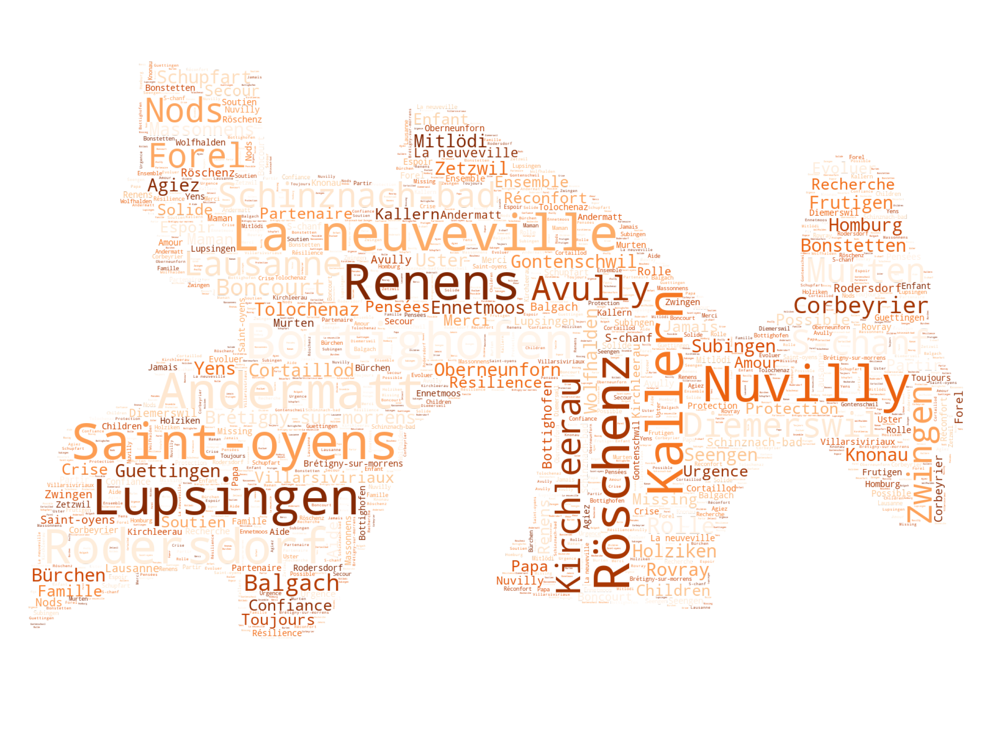

In [12]:
image = Image.open(path.join(os.getcwd(), 'data/souc.png')).convert('RGBA')
#new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
#new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

coloring = np.array(image)
wc = WordCloud(mode = "RGBA", width=400, height=300, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=80, random_state=41, colormap='Oranges')
wc.generate_from_frequencies(words_and_freqs)
#image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
#ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.imshow(wc)

fig.set_figheight(40)
fig.set_figwidth(40)
ax.set_axis_off()
plt.savefig('figs/#0g_transformed_format_reel.png', dpi=200)

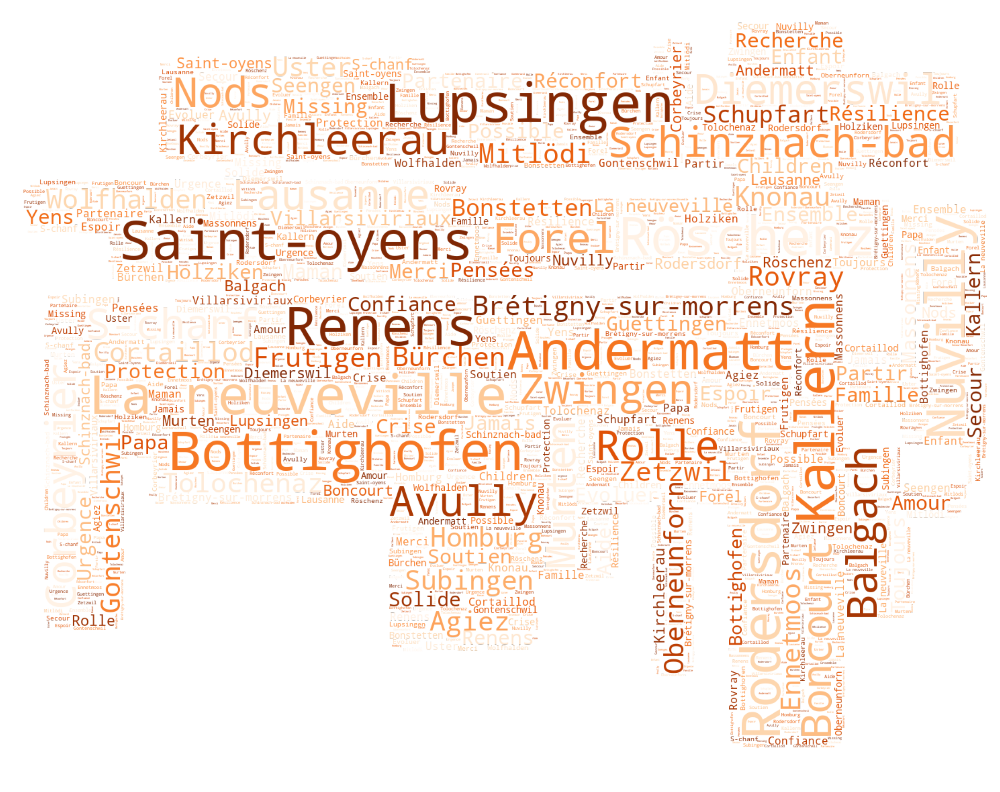

In [13]:
image = Image.open(path.join(os.getcwd(), 'data/abstract.png')).convert('RGBA')
#new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
#new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

coloring = np.array(image)
wc = WordCloud(mode = "RGBA", width=400, height=300, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=80, random_state=41, colormap='Oranges')
wc.generate_from_frequencies(words_and_freqs)
#image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
#ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.imshow(wc)

fig.set_figheight(40)
fig.set_figwidth(40)
ax.set_axis_off()
plt.savefig('figs/#0g_transformed_format_reel.png', dpi=200)

In [ ]:
image = Image.open(path.join(os.getcwd(), 'data/1.png')).convert('RGBA')
new_image = Image.new("RGBA", image.size, "WHITE") # Create a white rgba background
new_image.paste(image, (0, 0), image)              # Paste the image on the background. Go to the links given below for details.
#new_image.convert('RGB').save('test.jpg', "JPEG")

coloring = np.array(new_image)
wc = WordCloud(mode = "RGBA", width=400, height=300, background_color=None, max_words=2000, mask=coloring, repeat=True, scale=1,
               stopwords=None, contour_width=0, max_font_size=80, random_state=41, colormap='plasma')
wc.generate_from_frequencies(words_and_freqs)
#image_colors = ImageColorGenerator(coloring)

# show
fig, ax = plt.subplots(1, 1)
#ax.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
ax.imshow(wc)

fig.set_figheight(40)
fig.set_figwidth(40)
ax.set_axis_off()
plt.savefig('figs/1_transformed.png', dpi=200)